# Library

In [1]:
# Ignore the warnings
import warnings
# warnings.filterwarnings('always')
warnings.filterwarnings('ignore')

# System related and data input controls
import os

# Auto reload of library
%reload_ext autoreload
%autoreload 2

# Python path
import sys
base_folder = 'DataScience'
location_base = os.path.join(os.getcwd().split(base_folder)[0], base_folder)
location_module = [os.path.join(location_base, 'Module')] 
for each in location_module:
    if each not in sys.path:
        sys.path.append(each)

from import_KK import *
DeviceStrategy_CPU()
from data_KK import *
from description_KK import *
from preprocessing_KK import *
from preprocessing_text_KK import * ##
from algorithm_textmining_KK import * ##
from evaluation_KK import *
from visualization_KK import *

FONT_NAME = 'malgun'
plt.rc('font', family=FONT_NAME) 
plt.rcParams['font.family'] = FONT_NAME
mpl.rc('font', family=FONT_NAME)
sns.set(font=FONT_NAME) 
sys_font = font_manager.findSystemFonts()
FONT_PATHS = [path for path in sys_font if 'malgun' in path]
if len(FONT_PATHS) != 0:
    rc('font', family=font_manager.FontProperties(fname=FONT_PATHS[0]).get_name())

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package tagsets_json to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package tagsets_json is already up-to-date!
[Kss]: From C:\Users\KK\anaconda3\Lib\site-packages\tf_keras\src\losses.py:2976: The name tf.losses.sparse_softmax_cross_entropy is deprecated. Please use tf.compat.v1.losses.sparse_softmax_cross_entropy instead.



Cuda is Ready?  False

Tensorflow Version:  2.18.0
Keras Version:  3.7.0
Torch Version:  2.5.1+cpu


2025-05-16 10:22:14,970	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8265 
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


# Hyperparameters

In [30]:
# Data
if platform.system() == 'Linux' and 'microsoft' in os.uname().release.lower():
    DRIVE_LOCATION = '/mnt/d'
    # DRIVE_LOCATION = '/mnt/z'
elif platform.system() == 'Windows':
    DRIVE_LOCATION = 'Z:'
# FOLDER_LOCATION = os.path.join(DRIVE_LOCATION, 'Research', 'SavedData', 'NaverNewsCSR', 'Data')
FOLDER_LOCATION = os.path.join(DRIVE_LOCATION, '내 드라이브', 'Research', 'SavedData', 'NaverNewsCSR', 'Data')
DATA_NAME = 'NaverNews_키워드전체카테고리사회.csv'
TARGET = 'Title'
CATEGORY = 'Year'
NGRAM_RANGE = (1,1)
TFIDF_MAXCOL = 10000
TFIDF_DELLOWFREQ = False
KEYBERT_TOPNKWD = 5
NUM_SHOWKEYWORD = 200
WINDOW_SIZE = 1
KEYWORD_DELETE = ['경찰', '검찰']
# Model
TOKENIZER = 'KeyBERT'
# euclidean, manhattan, chebyshev, minkowski, canberra, braycurtis, mahalanobis, wminkowski, seuclidean, cosine, correlation
# haversine, hamming, jaccard, dice, russelrao, kulsinski, ll_dirichlet, hellinger, rogerstanimoto, sokalmichener, sokalsneath, yule
UMAP_METRIC = 'euclidean'
UMAP_SEED = 123
NUM_TOPICS = 'auto'
MAX_TOPICS = 10
NUM_TOPICWORDS = 10
NUM_TOPICSAMPLES = 5
# Save
SAVE_LOCAL = True
SAVE_NAME_FREQ = 'wordfreq'
SAVE_NAME_LDA = 'Topics_byTokenLDA.xlsx'
SAVE_NAME_BERTopic = 'Topics_byBERTopic.xlsx'

# Data Loading

In [3]:
# 데이터로딩: 원본
df_freq = pd.read_csv(os.path.join(FOLDER_LOCATION, 'df_prep_'+str(NGRAM_RANGE).replace(' ','')+'.csv'), encoding='utf-8-sig')
df_freq_categ = pd.read_csv(os.path.join(FOLDER_LOCATION, 'df_prepcateg_'+str(NGRAM_RANGE).replace(' ','')+'.csv'), encoding='utf-8-sig')
if NGRAM_RANGE[1] == 1:
    wordfreq_location = os.path.join('.', 'Result', 'WordFreq', 'NgramRange1')
elif NGRAM_RANGE[1] == 2:
    wordfreq_location = os.path.join('.', 'Result', 'WordFreq', 'NgramRange2')
word_freq = pd.read_csv(os.path.join(wordfreq_location, 'wf_'+TOKENIZER.lower()+'.csv'), encoding='utf-8-sig')
word_freq_categ = pd.read_csv(os.path.join(wordfreq_location, 'wf_categ_'+TOKENIZER.lower()+'.csv'), encoding='utf-8-sig')
## 결측치 처리
df_freq.dropna(subset=['TitlePrep'], inplace=True)
df_freq_categ.dropna(subset=['TitlePrep'], inplace=True)
## 특정 단어 필터링
if KEYWORD_DELETE != []:
    word_freq = word_freq[~word_freq.word.isin(KEYWORD_DELETE)].reset_index().iloc[:,1:]
    word_freq_categ = word_freq_categ[~word_freq_categ.word.isin(KEYWORD_DELETE)].reset_index().iloc[:,1:]
    df_freq = df_freq[~df_freq.TitlePrep.str.contains('|'.join(KEYWORD_DELETE))].reset_index().iloc[:,1:]
    df_freq_categ = df_freq_categ[~df_freq_categ.TitlePrep.str.contains('|'.join(KEYWORD_DELETE))].reset_index().iloc[:,1:]

In [ ]:
# # 동시발생 단어행렬 추출
# coword_direct, coword_undirect = preprocessing_sent2edgelist(df_freq[TARGET+'Prep'], 
#                                                              window_size=WINDOW_SIZE, save_local=SAVE_LOCAL)
# coword_directcateg, coword_undirectcateg = preprocessing_sent2edgelist_bycateg(df_freq, 
#                                                                                colname_target=TARGET+'Prep', colname_categ=CATEGORY, 
#                                                                                window_size=WINDOW_SIZE, save_local=SAVE_LOCAL)
# coword_directcateg.Year = coword_directcateg.Year.apply(lambda x: str(x)[:4])

# 동시출현 단어네트워크
coword_sub = coword_directcateg[coword_directcateg.source.isin(word_freq.word.values[:10])].reset_index().iloc[:,1:]
G, node_stat = preprocessing_GraphNX(coword_sub, direct=True)

# Result

,count,mean,std,min,25%,50%,75%,max
Length,"912,792.0000",7.9401,2.0086,1.0000,7.0000,8.0000,9.0000,46.0000


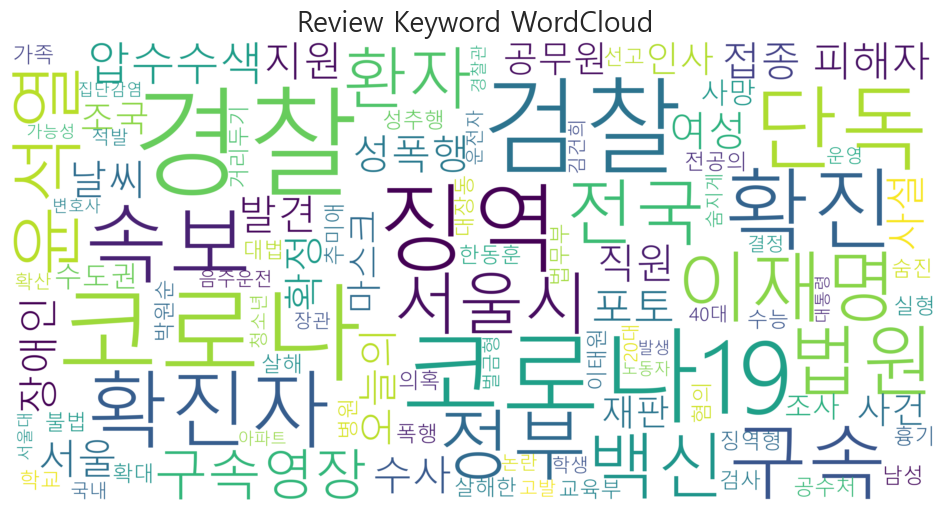

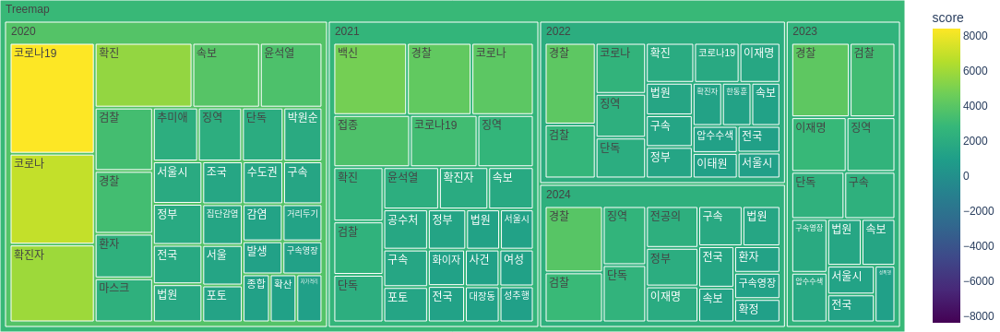

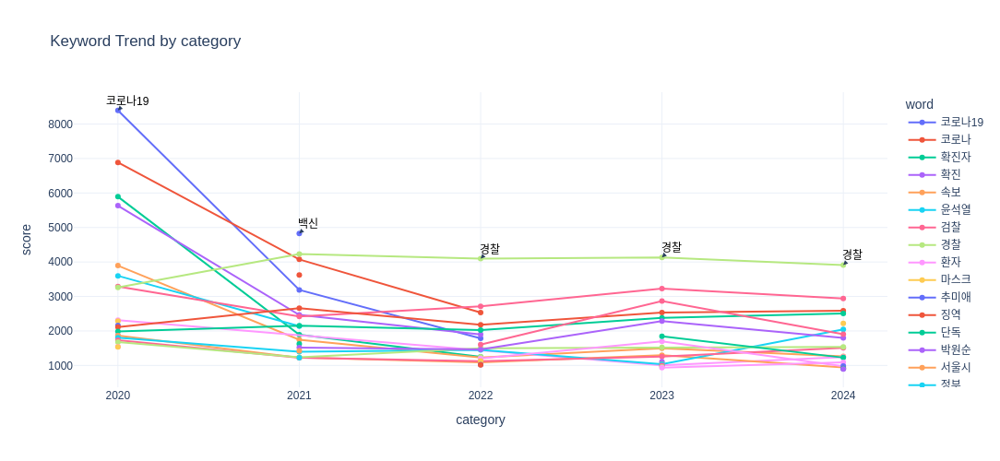

In [4]:
# 제목 토큰 길이 분포
plot_histogram_senttoken(df_freq['Token_'+TOKENIZER]) 

# 전체기간 주요키워드 분포
plot_donut_wordfreq(word_freq)
plot_wordcloud(word_freq, title='Review Keyword WordCloud', max_font_size=50, save_local=False)

# 연도별(리뷰) 주요키워드 분포
plot_treemap_wordfreq(word_freq_categ)

# 연도별 주요키워드 트랜드
## 연도별 주요키워드 상위10개 추출
df_plot = pd.DataFrame()
for year in word_freq_categ.category.unique():
    df_sub = word_freq_categ[word_freq_categ.category == year].iloc[:20,:]
    df_plot = pd.concat([df_plot, df_sub], axis=0)
## 트랜드 시각화
X = 'category'
Y = 'score'
COLOR = 'word'
fig = px.line(df_plot, x=X, y=Y, color=COLOR, markers=True,
              title="Keyword Trend by category")
## 각 고유 Viewing 값마다 weight가 가장 큰 데이터 포인트 추출
max_points = df_plot.loc[df_plot.groupby(X)[Y].idxmax()]
## 각 최대 weight 데이터 포인트 marker 근처에 source 이름을 annotation으로 추가
annotations = []
for idx, row in max_points.iterrows():
    annotations.append(dict(
        x=row[X],
        y=row[Y],
        xref="x",
        yref="y",
        text=row[COLOR],
        showarrow=True,
        arrowhead=2,
        ax=10,  # x 오프셋 (조정 가능)
        ay=-10, # y 오프셋 (조정 가능)
        font=dict(color="black", size=12)
    ))
fig.update_xaxes(tickmode='array', tickvals=df_plot[X].unique())
fig.update_layout(annotations=annotations, width=1000, height=500, showlegend=True)
fig.show()

In [5]:
# 특정키워드의 연도별 인접어 트랜드
# for col in node_stat.columns[1:]:
#     ## 하위그룹
#     top_nodes = node_stat.sort_values(by=col, ascending=False).word[:2]
#     G_sub = G.subgraph(top_nodes)

#     ## 동시출현 시각화
#     net = Network(notebook=True)
#     net.from_nx(G_sub)
#     net.show_buttons(filter_=['physics'])
#     net.toggle_physics(False)
#     net.show('network_'+col+'.html')

#     ## 단어중요도 변화 시각화
#     df_plot = coword_directcateg[coword_directcateg.source.isin(top_nodes)].sort_values(by=['Year', 'weight'], ascending=[True, False])
#     fig = px.line(df_plot, x='Year', y='weight', color='target', markers=True,
#                   title="Year vs. Weight by Source")
#     # # 각 고유 Viewing 값마다 weight가 가장 큰 데이터 포인트 추출
#     # max_points = df_plot.loc[df_plot.groupby('Year')['weight'].idxmax()]
#     # # 각 최대 weight 데이터 포인트 marker 근처에 source 이름을 annotation으로 추가
#     # annotations = []
#     # for idx, row in max_points.iterrows():
#     #     annotations.append(dict(
#     #         x=row['Year'],
#     #         y=row['weight'],
#     #         xref="x",
#     #         yref="y",
#     #         text=row['source'],
#     #         showarrow=True,
#     #         arrowhead=2,
#     #         ax=10,  # x 오프셋 (조정 가능)
#     #         ay=-10, # y 오프셋 (조정 가능)
#     #         font=dict(color="black", size=12)
#     #     ))
#     # fig.update_layout(annotations=annotations, width=1000, height=500, showlegend=False)
#     fig.show()

# Topic Modeling

2025-05-10 00:35:08,812	INFO worker.py:1619 -- Calling ray.init() again after it has already been called.


Optimal Topic Number:  6


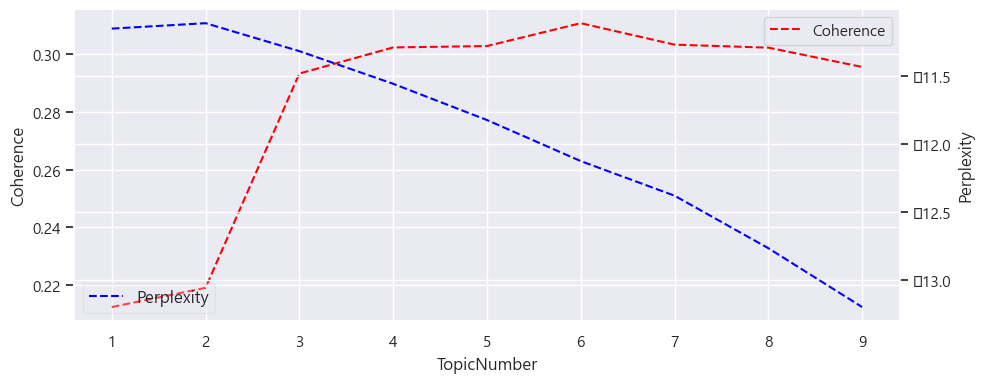

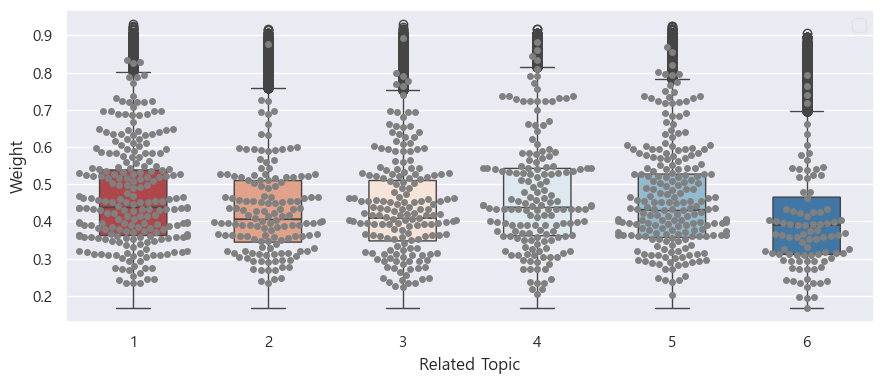

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'장애인(27.3%)', '서울시(18.2%)', '환자(13.3%)', '코로나19(9.1%)', '병원(7.0%)', '지원(5.6%)', '코로나(5.6%)', '단독...",202384,0.2217,0.4603
Topic 2,"'서울(16.0%)', '확진(12.3%)', '국내(10.4%)', '전장연(10.4%)', '사망(10.4%)', '초미세먼지(9.4%)', '응급실(8.5%)', '수...",142922,0.1566,0.4640
Topic 3,"'플라스틱(12.2%)', '확진자(12.2%)', '장애(11.1%)', '수돗물(11.1%)', '서울(10.0%)', '인천(10.0%)', '코로나(8.9%)', '...",162204,0.1777,0.4299
Topic 4,"'쓰레기(21.4%)', '포토(17.9%)', '지원(9.5%)', '확대(8.3%)', '개최(8.3%)', '운영(8.3%)', '위험(7.1%)', '개선(7.1%)...",134555,0.1474,0.4474
Topic 5,"'백신(17.6%)', '정부(13.0%)', '접종(13.0%)', '한강(10.2%)', '환경(8.3%)', '전공의(8.3%)', '폐기물(8.3%)', '진료(7....",185884,0.2036,0.4284
Topic 6,"'환경부(32.1%)', '미세먼지(16.5%)', '마스크(9.2%)', '수도권(7.3%)', '효과(7.3%)', '다시(5.5%)', '감소(5.5%)', '국민(5...",84843,0.0929,0.4062


In [6]:
# 주요토픽 트랜드
## LDA 자동
save_name = SAVE_NAME_LDA.split('.')[0]+'_NR'+str(NGRAM_RANGE[1])+'Topic{}.xlsx'.format(NUM_TOPICS)

topic_kw_LDA, topic_doc_LDA, \
doc_topic_LDA, model_LDA = modeling_LDA(df_freq['Token_'+TOKENIZER], df_freq['TitlePrep'],
                                        num_topics=NUM_TOPICS, max_topics=MAX_TOPICS,
                                        num_topicwords=NUM_TOPICWORDS, num_topicsamples=NUM_TOPICSAMPLES,
                                        save_local=SAVE_LOCAL, save_name=save_name)
display(topic_kw_LDA)

2020.0


2025-05-10 01:17:08,738	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 


Optimal Topic Number:  3


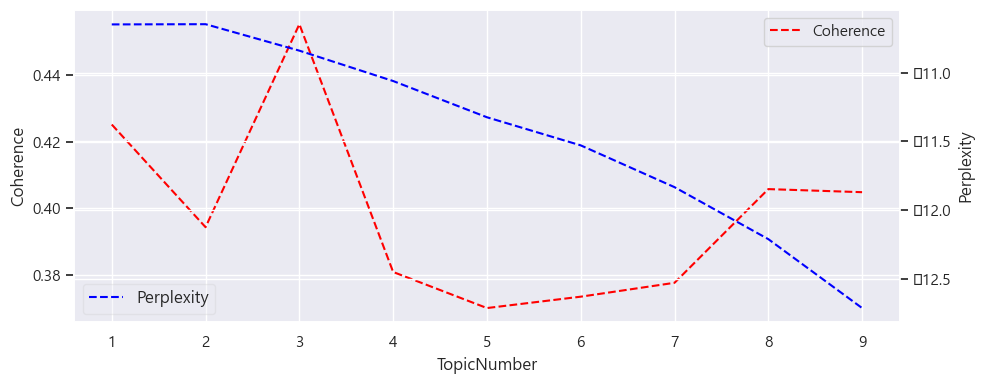

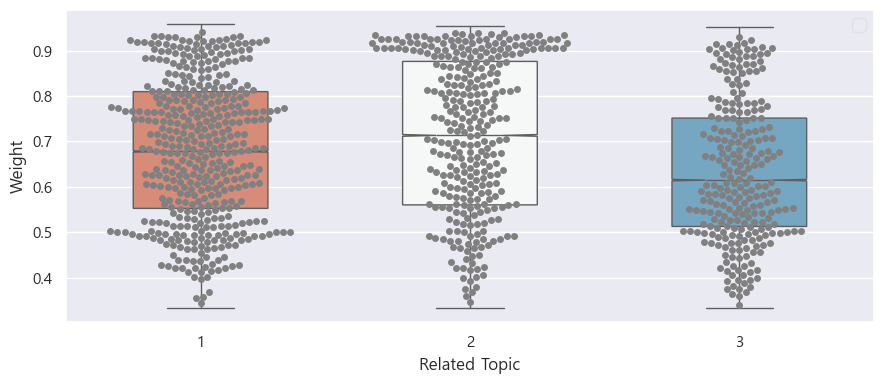

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'장애인(28.6%)', '서울시(17.9%)', '단독(8.9%)', '사설(8.9%)', '여성(7.1%)', '정부(7.1%)', '의사(5.4%)', '사망(5.4%...",90233,0.4353,0.6799
Topic 2,"'코로나19(17.0%)', '코로나(17.0%)', '확진(12.9%)', '확진자(11.6%)', '환자(9.5%)', '서울(7.5%)', '속보(6.8%)', '감염...",65676,0.3168,0.7055
Topic 3,"'접종(17.3%)', '지원(13.5%)', '독감(11.5%)', '수돗물(9.6%)', '치료(9.6%)', '유충(9.6%)', '미세먼지(7.7%)', '환경부(7...",51371,0.2478,0.6354


2021.0


2025-05-10 01:27:35,510	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 


Optimal Topic Number:  8


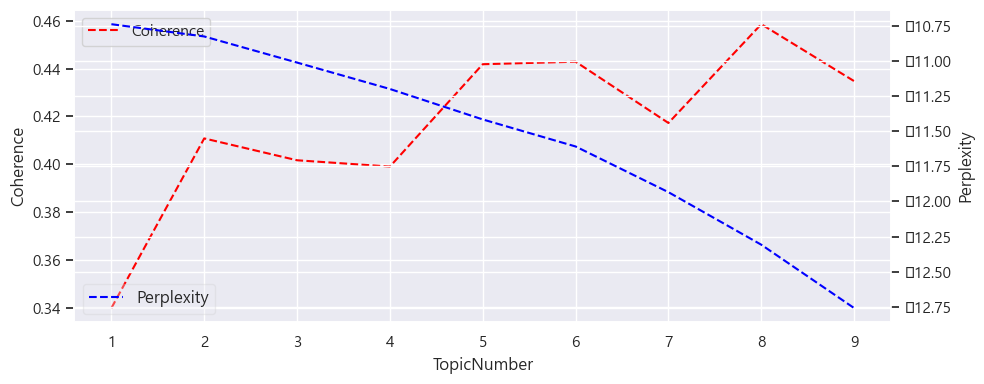

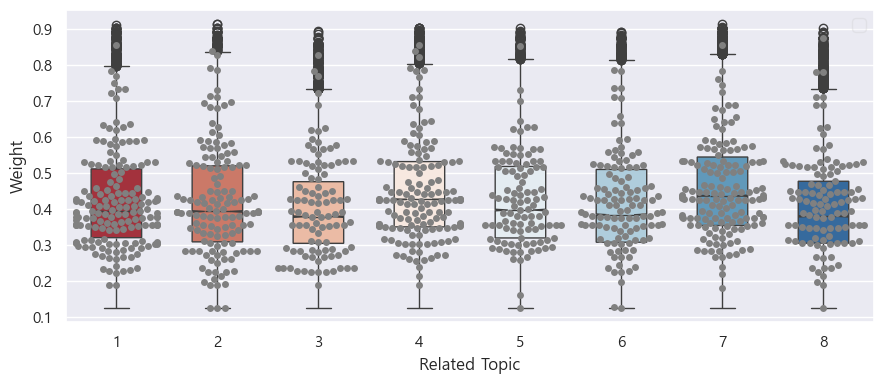

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'환자(26.2%)', '미세먼지(17.2%)', '1차(11.5%)', '당국(9.8%)', '서울시(7.4%)', '돌파(6.6%)', '대응(5.7%)', '발견(5....",26439,0.1404,0.4042
Topic 2,"'탄소중립(12.2%)', '백신접종(12.2%)', '확인(12.2%)', '사설(11.1%)', '확대(11.1%)', '배출(10.0%)', '장관(7.8%)', '경...",25246,0.1340,0.4503
Topic 3,"'장애인(33.8%)', '쓰레기(15.3%)', '위드(9.6%)', '다시(7.0%)', '국민(6.4%)', '맞고(6.4%)', '시행(5.7%)', '먹는(5.7%...",18315,0.0972,0.4044
Topic 4,"'백신(35.2%)', '접종(26.6%)', '화이자(8.2%)', '코로나(6.0%)', '부스터샷(6.0%)', '모더나(3.9%)', '사망(3.9%)', '서울시(...",28572,0.1517,0.4202
Topic 5,"'신규(14.0%)', '수도권(13.3%)', '여성(12.6%)', 'az(10.5%)', '국내(9.8%)', '지원(9.8%)', '전국(9.1%)', '선정(7.7...",19878,0.1055,0.4598
Topic 6,"'최다(18.4%)', '초미세먼지(14.3%)', '거리두기(11.2%)', '건강한(10.2%)', '증가(9.2%)', '가장(8.2%)', '건강(7.1%)', '7...",20313,0.1079,0.4128
Topic 7,"'코로나(18.7%)', '코로나19(18.1%)', '확진(13.0%)', '확진자(11.4%)', '포토(8.3%)', '위중증(7.8%)', '서울(6.2%)', '감...",28552,0.1516,0.4176
Topic 8,"'환경부(22.8%)', '추가(11.8%)', '치료(11.0%)', '위험(9.6%)', '환경(8.1%)', '치료제(8.1%)', '개최(8.1%)', '20대(7....",21023,0.1116,0.4233


2022.0


2025-05-10 01:36:38,002	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 


Optimal Topic Number:  8


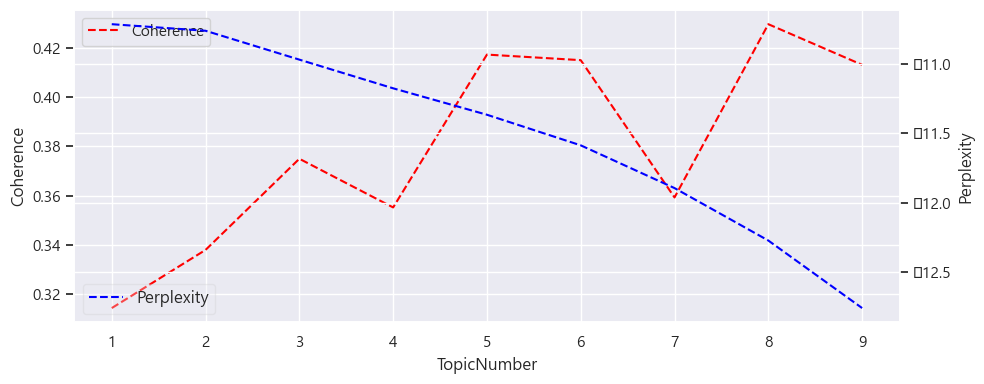

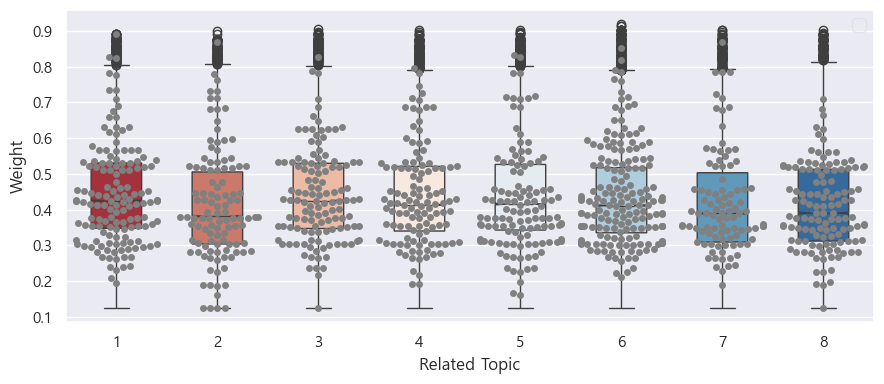

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'장애인(28.0%)', '서울시(14.9%)', '정부(11.2%)', '시위(9.9%)', '지원(8.1%)', '포토(8.1%)', '최다(5.6%)', '수술(5.0...",23284,0.1405,0.4042
Topic 2,"'환자(26.7%)', '지하철(14.5%)', '마스크(12.7%)', '출근길(9.1%)', '하루(7.9%)', '해제(6.7%)', '건강(6.7%)', '연속(5....",16114,0.0972,0.4182
Topic 3,"'코로나(27.0%)', '확진자(11.5%)', '신규(11.5%)', '위중증(10.8%)', '코로나19(10.1%)', '병원(6.8%)', '신규확진(6.1%)',...",18921,0.1142,0.4300
Topic 4,"'확진(24.3%)', '접종(16.2%)', '코로나19(10.3%)', '가족(8.8%)', '증가(8.1%)', '건강한(7.4%)', '오미크론(6.6%)', '발생...",20107,0.1213,0.4433
Topic 5,"'여성(22.4%)', '서울(13.3%)', '유행(9.2%)', '장애(9.2%)', '개최(8.2%)', '시작(8.2%)', '재개(8.2%)', '발견(7.1%)'...",19252,0.1162,0.4364
Topic 6,"'환경부(18.1%)', '쓰레기(17.3%)', '국내(15.0%)', '발달장애인(8.7%)', '경찰(7.9%)', '이태원(7.9%)', '참사(7.9%)', '확인...",30300,0.1828,0.4437
Topic 7,"'백신(32.8%)', '코로나(14.7%)', '다시(10.3%)', '효과(8.6%)', '의사(6.9%)', '먹는(6.0%)', '격리(6.0%)', '의무(5.2%...",17945,0.1083,0.4135
Topic 8,"'전장연(21.5%)', '사망(18.8%)', '위험(14.1%)', '치료(12.8%)', '인사(6.7%)', '낙동강(6.0%)', '획득(5.4%)', '재택치료(...",19814,0.1196,0.4328


2023.0


2025-05-10 01:44:41,999	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 


Optimal Topic Number:  5


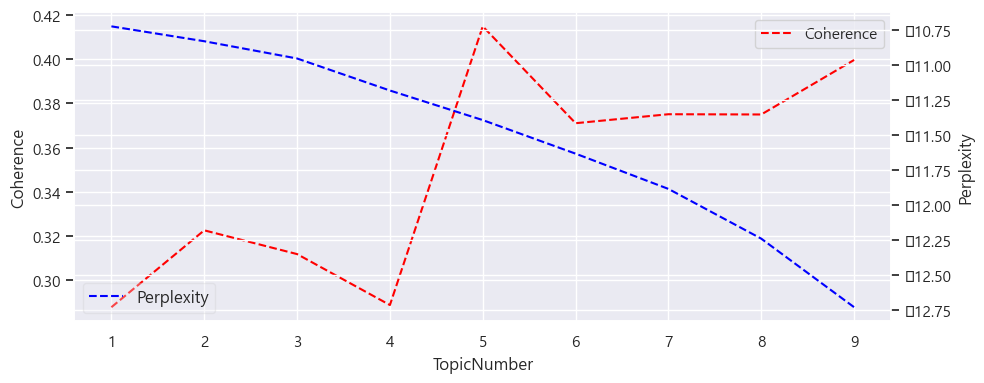

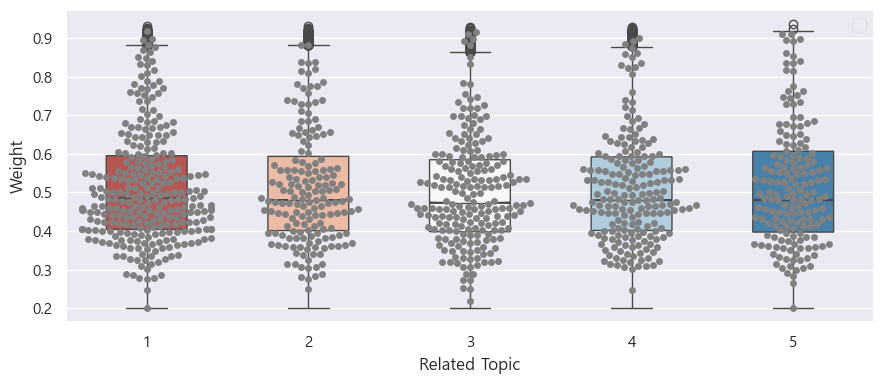

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'장애인(36.7%)', '치료(11.4%)', '미세먼지(8.9%)', '여성(7.6%)', '코로나19(6.3%)', '경찰(6.3%)', '환경(6.3%)', '남성(...",46419,0.2537,0.5085
Topic 2,"'서울시(23.4%)', '지원(20.8%)', '운영(7.8%)', '서울(7.8%)', '정부(7.8%)', '장애(7.8%)', '건강(6.5%)', '최대(6.5%)...",32791,0.1792,0.5062
Topic 3,"'환자(26.8%)', '위험(11.0%)', '병원(9.8%)', '진료(9.8%)', '쓰레기(8.5%)', '증가(8.5%)', '의사(7.3%)', '인사(6.1%)...",37148,0.2030,0.5007
Topic 4,"'환경부(21.4%)', '여성(12.9%)', '사망(11.4%)', '수상(10.0%)', '지하철(8.6%)', '관리(8.6%)', '선정(7.1%)', '발생(7....",38167,0.2086,0.5075
Topic 5,"'포토(18.2%)', '전장연(13.0%)', '개최(11.7%)', '가족(10.4%)', '건강한(9.1%)', '2023(7.8%)', '수술(7.8%)', '시위(...",28468,0.1556,0.5104


2024.0


2025-05-10 01:53:47,492	INFO worker.py:1777 -- Started a local Ray instance. View the dashboard at http://127.0.0.1:8266 


Optimal Topic Number:  7


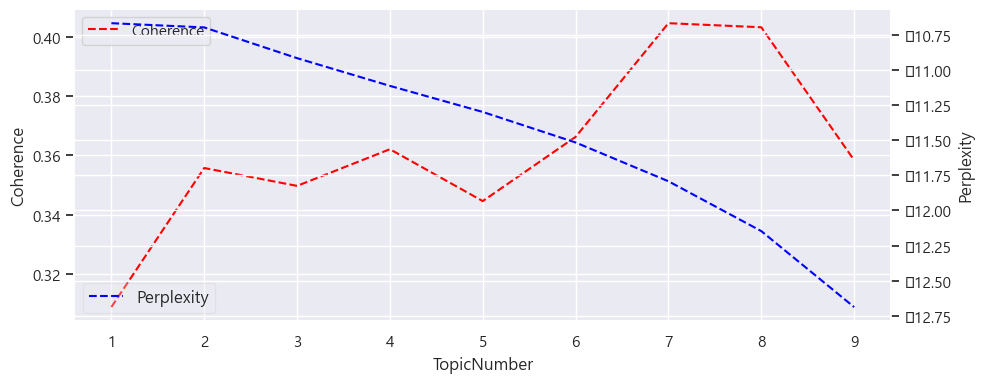

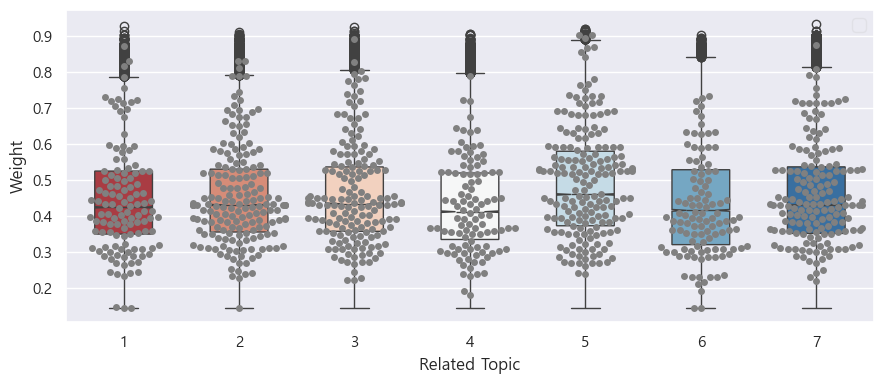

,Related Keywords,Number of Sentences,Percentage,Average Probability
Topic 1,"'지원(22.1%)', '속보(10.4%)', '서울(10.4%)', '추진(10.4%)', '국민(9.1%)', '내년(9.1%)', '20대(7.8%)', '최대(7.8...",20742,0.1231,0.4858
Topic 2,"'건강(17.5%)', '강화(12.5%)', '증가(12.5%)', '코로나(10.0%)', '개최(8.7%)', '현장(8.7%)', '출산(7.5%)', '기부(7.5...",27933,0.1658,0.4570
Topic 3,"'환자(22.2%)', '장애인(22.2%)', '여성(12.6%)', '환경부(10.4%)', '플라스틱(7.4%)', '지원(6.7%)', '가족(5.2%)', '환경(...",26500,0.1573,0.4348
Topic 4,"'사망(18.8%)', '서울(15.3%)', '치매(11.8%)', '효과(10.6%)', '발달장애인(9.4%)', '남성(8.2%)', '2024(7.1%)', '발견...",19911,0.1182,0.4385
Topic 5,"'정부(15.2%)', '전공의(13.9%)', '병원(13.2%)', '응급실(11.9%)', '의사(10.6%)', '쓰레기(8.6%)', '진료(7.9%)', '수술(...",27951,0.1659,0.4514
Topic 6,"'서울시(31.0%)', '위험(11.2%)', '추석(9.5%)', '전국(8.6%)', '선정(8.6%)', '수상(6.9%)', '가장(6.9%)', '인천(6.0%)...",17216,0.1022,0.4522
Topic 7,"'한강(20.4%)', '포토(20.4%)', '인사(10.8%)', '관리(8.6%)', '미세먼지(7.5%)', '연속(7.5%)', '초미세먼지(6.5%)', '장관(...",28191,0.1674,0.4427


In [8]:
# 연도별 주요토픽 트랜드
for year in df_freq.Year.unique():
    print(year)
    ## 데이터 분리
    save_name = SAVE_NAME_LDA.split('.')[0]+'_NR'+str(NGRAM_RANGE[1])+'Topic{}_{}.xlsx'.format(NUM_TOPICS, str(year)[:4])
    df_sub = df_freq[df_freq.Year == year].reset_index().iloc[:,1:]

    ## LDA 자동
    topic_kw_LDA, topic_doc_LDA, \
    doc_topic_LDA, model_LDA = modeling_LDA(df_sub['Token_'+TOKENIZER], df_sub['TitlePrep'],
                                            num_topics=NUM_TOPICS, max_topics=MAX_TOPICS,
                                            num_topicwords=NUM_TOPICWORDS, num_topicsamples=NUM_TOPICSAMPLES,
                                            save_local=SAVE_LOCAL, save_name=save_name)
    display(topic_kw_LDA)

# Sentiment Analysis